# How to Approach Machine Learning Projects


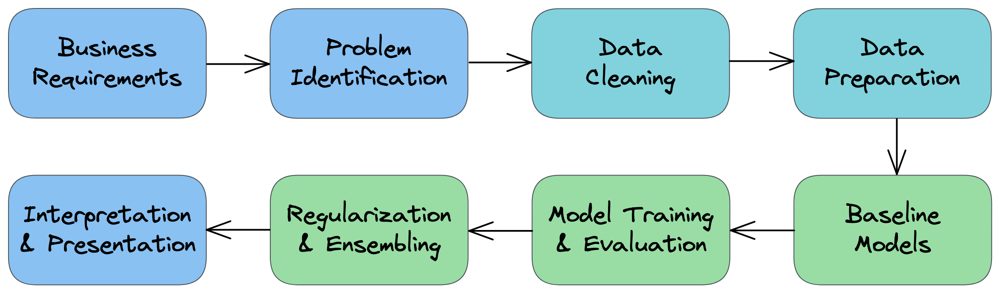

In [1]:
from IPython.display import Image
Image(filename='Images/MLflow.png')

### we'll explore a step-by-step process for approaching ML problems:

* Understand the business requirements and the nature of the available data.
* Classify the problem as supervised/unsupervised and regression/classification.
* Download, clean & explore the data and create new features(i.e. Feature Enginnering) that may improve models.
* Create training/test/validation sets and prepare the data for training ML models.
* Create a quick & easy baseline model to evaluate and benchmark future models.
* Pick a modeling strategy, train a model, and tune hyperparameters to achieve optimal fit.
* Experiment and combine results from multiple strategies to get a better result.
* Interpret models, study individual predictions, and present your findings.









In [1]:
# for visualization
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import opendatasets as od   # to download datasets by url
import pandas as pd   # for working with datasets
import numpy as np    # for numerical computing
%matplotlib inline

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10,6)
#matplotlib.rcParams['figure.facecolor'] = '#000000'

## Step 1 - Understand Business Requirements & Nature of Data

Most machine learning models are trained to serve a real-world use case. It's important to understand the business requirements, modeling objectives and the nature of the data available before you start building a machine learning model.

The first step in any machine learning problem is to read the given documentation, talk to various stakeholders and identify the following:

* What is the business problem you're trying to solve using machine learning?
* Why are we interested in solving this problem? What impact will it have on the business?
* How is this problem solved currently, without any machine learning tools?
* Who will use the results of this model, and how does it fit into other business processes?
* How much historical data do we have, and how was it collected?
* What features does the historical data contain? Does it contain the historical values for what we're trying to predict.
* What are some known issues with the data (data entry errors, missing data, differences in units etc.)
* Can we look at some sample rows from the dataset? How representative are they of the entire dataset.
* Where is the data stored and how will you get access to it?

  
dataset - https://www.kaggle.com/c/rossmann-store-sales








## Step 2 - Classify the problem as supervised/unsupervised & regression/classification


### Supervised Learning

where we know what we want to predict, for example we want to predict Sales at Rossman or we want to predict whether a tumor is cancerous or not

### UnSupervised Learning

where we dont have any targets where we are primarily just interested in learning the structure of the data. for example lets just we have a lot of activity of customers on our website and we want to figure which customers are less frequent visitors and which customers are power users and whch customers lie in between so that becomes a clustering problem, where we want to group customers into similar cluster and study those clusters

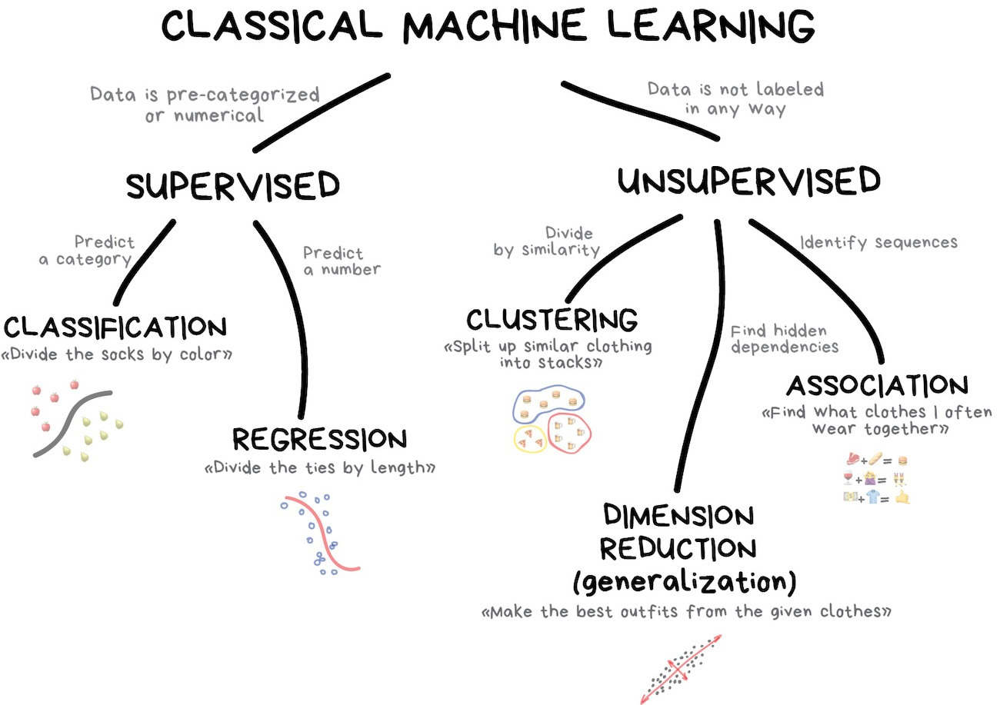

In [5]:
Image('Images/type.png')

EXERCISE: What type of problem is store sales prediction: https://www.kaggle.com/c/rossmann-store-sales ?

EXERCISE: What type of problem is breast cancer identification: https://www.kaggle.com/uciml/breast-cancer-wisconsin-data ?

EXERCISE: What type of problem is mall customer segmentation: https://www.kaggle.com/vjchoudhary7/customer-segmentation-tutorial-in-python






### Loss Functions and Evaluation Metrics
Once you have identified the type of problem you're solving, you need to pick an appropriate evaluation metric. Also, depending on the kind of model you train, your model will also use a loss/cost function to optimize during the training process.

* Evaluation metrics - they're used by humans to evaluate the ML model.
* Loss functions - they're used by computers to optimize the ML model.


See this article for a survey of common loss functions and evaluation metrics: https://towardsdatascience.com/11-evaluation-metrics-data-scientists-should-be-familiar-with-lessons-from-a-high-rank-kagglers-8596f75e58a7











## Step 3 - Download, clean & explore the data and create new features


In [6]:
od.download('https://www.kaggle.com/c/rossmann-store-sales/rules')

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username:

  neha1107


Your Kaggle Key:

  ········


100%|██████████████████████████████████████████████████████████████████████████████| 6.99M/6.99M [00:09<00:00, 769kB/s]


Extracting archive .\rossmann-store-sales/rossmann-store-sales.zip to .\rossmann-store-sales


In [3]:
import os
os.listdir('rossmann-store-sales/')

['sample_submission.csv', 'store.csv', 'test.csv', 'train.csv']

In [3]:
ross_df = pd.read_csv('rossmann-store-sales/train.csv')
ross_df

C:\Users\snikh\AppData\Local\Temp\ipykernel_15296\754279432.py:1: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  ross_df = pd.read_csv('rossmann-store-sales/train.csv')


,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday
0,1,5,2015-07-31,5263,555,1,1,0,1
1,2,5,2015-07-31,6064,625,1,1,0,1
2,3,5,2015-07-31,8314,821,1,1,0,1
3,4,5,2015-07-31,13995,1498,1,1,0,1
4,5,5,2015-07-31,4822,559,1,1,0,1
...,...,...,...,...,...,...,...,...,...
1017204,1111,2,2013-01-01,0,0,0,0,a,1
1017205,1112,2,2013-01-01,0,0,0,0,a,1
1017206,1113,2,2013-01-01,0,0,0,0,a,1
1017207,1114,2,2013-01-01,0,0,0,0,a,1


In [4]:
store_df = pd.read_csv('rossmann-store-sales/store.csv')
store_df

,Store,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
1110,1111,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1111,1112,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1112,1113,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
1113,1114,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN


We can merge the two data frames to get a richer set of features for each row of the training set.



In [5]:
merged_df = ross_df.merge(store_df, how='left', on='Store')
merged_df

,Store,DayOfWeek,Date,Sales,Customers,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,5,2015-07-31,5263,555,1,1,0,1,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,5,2015-07-31,6064,625,1,1,0,1,a,a,570.0,11.0,2007.0,1,13.0,2010.0,"Jan,Apr,Jul,Oct"
2,3,5,2015-07-31,8314,821,1,1,0,1,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
3,4,5,2015-07-31,13995,1498,1,1,0,1,c,c,620.0,9.0,2009.0,0,NaN,NaN,NaN
4,5,5,2015-07-31,4822,559,1,1,0,1,a,a,29910.0,4.0,2015.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1017204,1111,2,2013-01-01,0,0,0,0,a,1,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
1017205,1112,2,2013-01-01,0,0,0,0,a,1,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
1017206,1113,2,2013-01-01,0,0,0,0,a,1,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
1017207,1114,2,2013-01-01,0,0,0,0,a,1,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN


In [6]:
merged_df.shape

(1017209, 18)

In [7]:
test_df = pd.read_csv('rossmann-store-sales/test.csv')
test_df


,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday
0,1,1,4,2015-09-17,1.0,1,0,0
1,2,3,4,2015-09-17,1.0,1,0,0
2,3,7,4,2015-09-17,1.0,1,0,0
3,4,8,4,2015-09-17,1.0,1,0,0
4,5,9,4,2015-09-17,1.0,1,0,0
...,...,...,...,...,...,...,...,...
41083,41084,1111,6,2015-08-01,1.0,0,0,0
41084,41085,1112,6,2015-08-01,1.0,0,0,0
41085,41086,1113,6,2015-08-01,1.0,0,0,0
41086,41087,1114,6,2015-08-01,1.0,0,0,0


In [8]:
ross_df.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday'],
      dtype='object')

In [9]:
test_df.columns

Index(['Id', 'Store', 'DayOfWeek', 'Date', 'Open', 'Promo', 'StateHoliday',
       'SchoolHoliday'],
      dtype='object')

In [10]:
merged_test_df = test_df.merge(store_df, how='left', on='Store')
merged_test_df

,Id,Store,DayOfWeek,Date,Open,Promo,StateHoliday,SchoolHoliday,StoreType,Assortment,CompetitionDistance,CompetitionOpenSinceMonth,CompetitionOpenSinceYear,Promo2,Promo2SinceWeek,Promo2SinceYear,PromoInterval
0,1,1,4,2015-09-17,1.0,1,0,0,c,a,1270.0,9.0,2008.0,0,NaN,NaN,NaN
1,2,3,4,2015-09-17,1.0,1,0,0,a,a,14130.0,12.0,2006.0,1,14.0,2011.0,"Jan,Apr,Jul,Oct"
2,3,7,4,2015-09-17,1.0,1,0,0,a,c,24000.0,4.0,2013.0,0,NaN,NaN,NaN
3,4,8,4,2015-09-17,1.0,1,0,0,a,a,7520.0,10.0,2014.0,0,NaN,NaN,NaN
4,5,9,4,2015-09-17,1.0,1,0,0,a,c,2030.0,8.0,2000.0,0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41083,41084,1111,6,2015-08-01,1.0,0,0,0,a,a,1900.0,6.0,2014.0,1,31.0,2013.0,"Jan,Apr,Jul,Oct"
41084,41085,1112,6,2015-08-01,1.0,0,0,0,c,c,1880.0,4.0,2006.0,0,NaN,NaN,NaN
41085,41086,1113,6,2015-08-01,1.0,0,0,0,a,c,9260.0,NaN,NaN,0,NaN,NaN,NaN
41086,41087,1114,6,2015-08-01,1.0,0,0,0,a,c,870.0,NaN,NaN,0,NaN,NaN,NaN


In [11]:
merged_df.dtypes

Store                          int64
DayOfWeek                      int64
Date                          object
Sales                          int64
Customers                      int64
Open                           int64
Promo                          int64
StateHoliday                  object
SchoolHoliday                  int64
StoreType                     object
Assortment                    object
CompetitionDistance          float64
CompetitionOpenSinceMonth    float64
CompetitionOpenSinceYear     float64
Promo2                         int64
Promo2SinceWeek              float64
Promo2SinceYear              float64
PromoInterval                 object
dtype: object

In [12]:
merged_test_df.dtypes

Id                             int64
Store                          int64
DayOfWeek                      int64
Date                          object
Open                         float64
Promo                          int64
StateHoliday                  object
SchoolHoliday                  int64
StoreType                     object
Assortment                    object
CompetitionDistance          float64
CompetitionOpenSinceMonth    float64
CompetitionOpenSinceYear     float64
Promo2                         int64
Promo2SinceWeek              float64
Promo2SinceYear              float64
PromoInterval                 object
dtype: object

### Cleaning Data

In [13]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1017209 entries, 0 to 1017208
Data columns (total 18 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   Store                      1017209 non-null  int64  
 1   DayOfWeek                  1017209 non-null  int64  
 2   Date                       1017209 non-null  object 
 3   Sales                      1017209 non-null  int64  
 4   Customers                  1017209 non-null  int64  
 5   Open                       1017209 non-null  int64  
 6   Promo                      1017209 non-null  int64  
 7   StateHoliday               1017209 non-null  object 
 8   SchoolHoliday              1017209 non-null  int64  
 9   StoreType                  1017209 non-null  object 
 10  Assortment                 1017209 non-null  object 
 11  CompetitionDistance        1014567 non-null  float64
 12  CompetitionOpenSinceMonth  693861 non-null   float64
 13  CompetitionO

In [14]:
des_df =round(merged_df.describe().T,2)
des_df

,count,mean,std,min,25%,50%,75%,max
Store,1017209.0,558.43,321.91,1.0,280.0,558.0,838.0,1115.0
DayOfWeek,1017209.0,4.00,2.00,1.0,2.0,4.0,6.0,7.0
Sales,1017209.0,5773.82,3849.93,0.0,3727.0,5744.0,7856.0,41551.0
Customers,1017209.0,633.15,464.41,0.0,405.0,609.0,837.0,7388.0
Open,1017209.0,0.83,0.38,0.0,1.0,1.0,1.0,1.0
Promo,1017209.0,0.38,0.49,0.0,0.0,0.0,1.0,1.0
SchoolHoliday,1017209.0,0.18,0.38,0.0,0.0,0.0,0.0,1.0
CompetitionDistance,1014567.0,5430.09,7715.32,20.0,710.0,2330.0,6890.0,75860.0
CompetitionOpenSinceMonth,693861.0,7.22,3.21,1.0,4.0,8.0,10.0,12.0
CompetitionOpenSinceYear,693861.0,2008.69,5.99,1900.0,2006.0,2010.0,2013.0,2015.0


In [15]:
merged_df.duplicated().sum()

0

In [16]:
merged_df.dtypes

Store                          int64
DayOfWeek                      int64
Date                          object
Sales                          int64
Customers                      int64
Open                           int64
Promo                          int64
StateHoliday                  object
SchoolHoliday                  int64
StoreType                     object
Assortment                    object
CompetitionDistance          float64
CompetitionOpenSinceMonth    float64
CompetitionOpenSinceYear     float64
Promo2                         int64
Promo2SinceWeek              float64
Promo2SinceYear              float64
PromoInterval                 object
dtype: object

In [17]:
merged_df['Date'] = pd.to_datetime(merged_df.Date)

In [18]:
merged_test_df['Date'] = pd.to_datetime(merged_test_df.Date)

In [19]:
merged_df.Date.min(), merged_df.Date.max()

(Timestamp('2013-01-01 00:00:00'), Timestamp('2015-07-31 00:00:00'))

In [20]:
merged_test_df.Date.min(), merged_test_df.Date.max()

(Timestamp('2015-08-01 00:00:00'), Timestamp('2015-09-17 00:00:00'))

## Exploratory Data Analysis and Visualization


Objectives of exploratory data analysis:

* Study the distributions of individual columns (uniform, normal, exponential)
* Detect anomalies or errors in the data (e.g. missing/incorrect values).
* Study the relationship of target column with other columns (linear, non-linear etc.)
* Gather insights about the problem and the dataset.
* Came up with ideas for preprocessing and feature engineering.






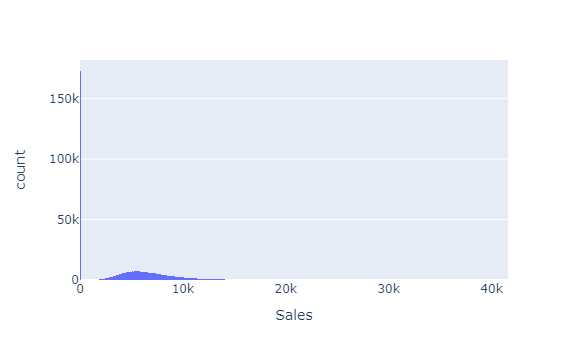

In [21]:
px.histogram(merged_df, x='Sales')

<AxesSubplot: xlabel='Sales', ylabel='Count'>

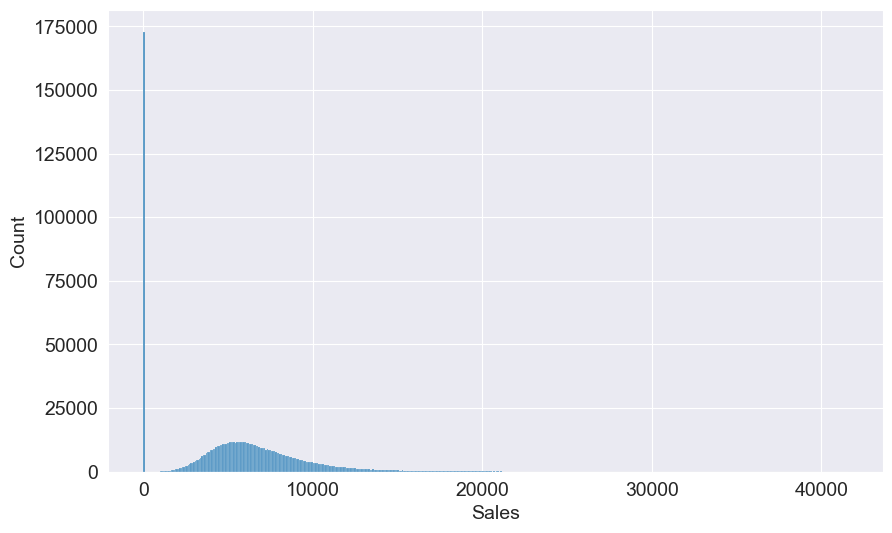

In [23]:
sns.histplot(data=merged_df, x='Sales')
#plt.tick_params(axis='both', colors='white')

why the sales are 0 on so many dates?

Let's check if this is because the store was closed

In [24]:
merged_df.Open.value_counts() #/ len(merged_df.Open)

1    844392
0    172817
Name: Open, dtype: int64

How will our model predict zero sales on days when the store is closed? It is better to remove these rows from the dataset

In [25]:
merged_df.Sales.value_counts()

0        172871
5674        215
5558        197
5483        196
6214        195
          ...  
23806         1
24183         1
20651         1
25083         1
23303         1
Name: Sales, Length: 21734, dtype: int64

In [26]:
merged_df = merged_df[merged_df.Open==1].copy()

In [27]:
merged_df.Sales.value_counts()

5674     215
5558     197
5483     196
6049     195
6214     195
        ... 
24219      1
22386      1
27057      1
18250      1
23303      1
Name: Sales, Length: 21734, dtype: int64

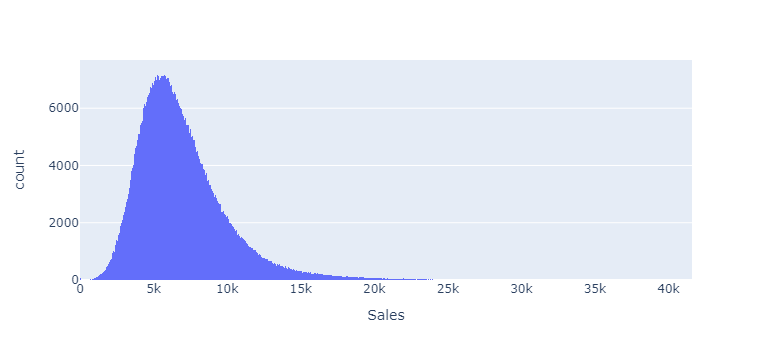

In [28]:
px.histogram(merged_df, x='Sales')

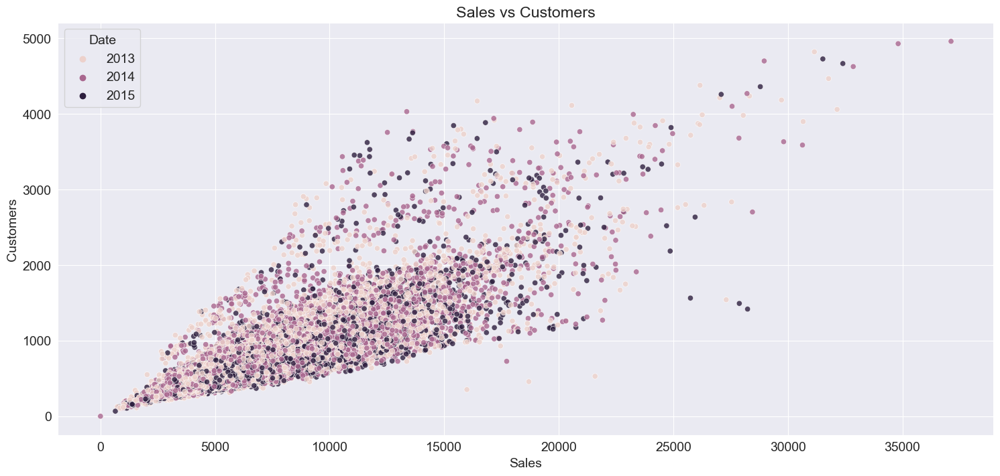

In [29]:
plt.figure(figsize=(18,8))
temp_df = merged_df.sample(40000)
sns.scatterplot(x=temp_df.Sales, y= temp_df.Customers, hue=temp_df.Date.dt.year, alpha=0.8)
#px.scatter(temp_df, x=temp_df.Sales, y = temp_df.Customers, hover_data= temp_df.Date.dt.year)
#plt.tick_params(axis='both', colors='white')
plt.title('Sales vs Customers')
plt.show()

but we can not use customers column as we dont know how many customers will visit the store few days later

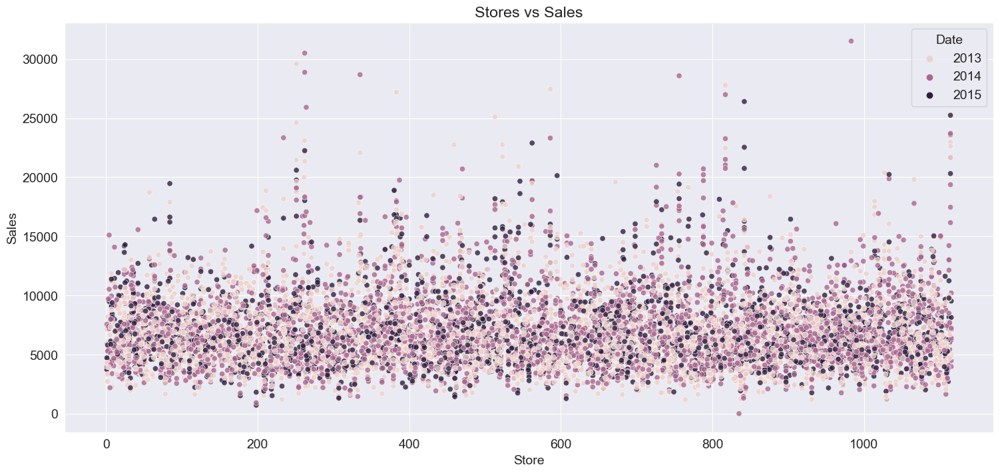

In [30]:
plt.figure(figsize=(18,8))
temp_df = merged_df.sample(10000)
sns.scatterplot(x=temp_df.Store, y= temp_df.Sales, hue= temp_df.Date.dt.year, alpha=0.8)
plt.title('Stores vs Sales')
#plt.tick_params(axis='both', colors='white')
plt.show()

<AxesSubplot: xlabel='DayOfWeek', ylabel='Sales'>

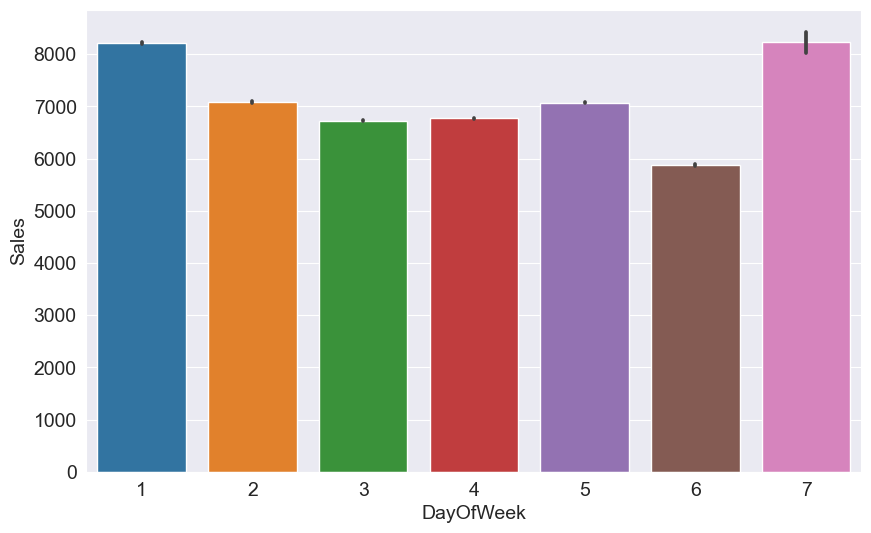

In [31]:
sns.barplot(data=merged_df, x='DayOfWeek', y='Sales')
#plt.tick_params(axis='both', colors='white')


<AxesSubplot: xlabel='Promo', ylabel='Sales'>

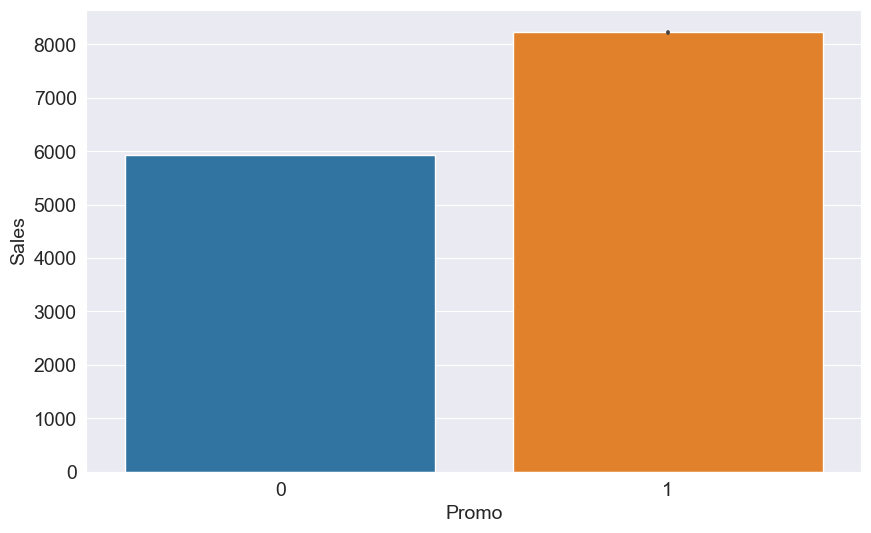

In [32]:
sns.barplot(data=merged_df, x='Promo', y='Sales')
#plt.bar()
#plt.tick_params(axis='both', colors='white')


In [33]:
merged_df.corr()['Sales'].sort_values(ascending=False)

C:\Users\snikh\AppData\Local\Temp\ipykernel_15296\1449935727.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



Sales                        1.000000
Customers                    0.823597
Promo                        0.368145
Promo2SinceWeek              0.095311
SchoolHoliday                0.038617
CompetitionOpenSinceYear     0.016101
Store                        0.007710
Promo2SinceYear             -0.034713
CompetitionDistance         -0.036396
CompetitionOpenSinceMonth   -0.043489
Promo2                      -0.127596
DayOfWeek                   -0.178736
Open                              NaN
Name: Sales, dtype: float64

* Id - an Id that represents a (Store, Date) duple within the test set
* Store - a unique Id for each store
* Sales - the turnover for any given day (this is what you are predicting)
* Customers - the number of customers on a given day
* Open - an indicator for whether the store was open: 0 = closed, 1 = open
* StateHoliday - indicates a state holiday. Normally all stores, with few exceptions, are closed on state holidays. Note that all schools are closed on public holidays and weekends. a = public holiday, b = Easter holiday, c = Christmas, 0 = None
* SchoolHoliday - indicates if the (Store, Date) was affected by the closure of public schools
* StoreType - differentiates between 4 different store models: a, b, c, d
* Assortment - describes an assortment level: a = basic, b = extra, c = extended
* CompetitionDistance - distance in meters to the nearest competitor store
* CompetitionOpenSince[Month/Year] - gives the approximate year and month of the time the nearest competitor was opened
* Promo - indicates whether a store is running a promo on that day
* Promo2 - Promo2 is a continuing and consecutive promotion for some stores: 0 = store is not participating, 1 = store is participating
* Promo2Since[Year/Week] - describes the year and calendar week when the store started participating in Promo2
* PromoInterval - describes the consecutive intervals Promo2 is started, naming the months the promotion is started anew. E.g. "Feb,May,Aug,Nov" means each round starts in February, May, August, November of any given year for that store

### Feature Engineering

Feature engineering is the process of creating new features (columns) by transforming/combining existing features or by incorporating data from external sources.

For example, here are some features that can be extracted from the "Date" column:

* Day of week
* Day or month
* Month
* Year
* Weekend/Weekday
* Month/Quarter End

In [34]:
merged_df['Day'] = merged_df.Date.dt.day
merged_df['Month'] = merged_df.Date.dt.month
merged_df['Year'] = merged_df.Date.dt.year

In [35]:
merged_test_df['Day'] = merged_test_df.Date.dt.day
merged_test_df['Month'] = merged_test_df.Date.dt.month
merged_test_df['Year'] = merged_test_df.Date.dt.year

In [36]:
len(merged_df)

844392

In [37]:
merged_df.StateHoliday.value_counts()

0    731342
0    112140
a       694
b       145
c        71
Name: StateHoliday, dtype: int64

In [38]:
merged_df['StateHoliday'] = merged_df['StateHoliday'].replace(0, '0')


In [39]:
merged_df.StateHoliday.value_counts()

0    843482
a       694
b       145
c        71
Name: StateHoliday, dtype: int64

In [40]:
merged_df.StateHoliday.unique()

array(['0', 'a', 'b', 'c'], dtype=object)

In [41]:
merged_test_df.StateHoliday.unique()

array(['0', 'a'], dtype=object)

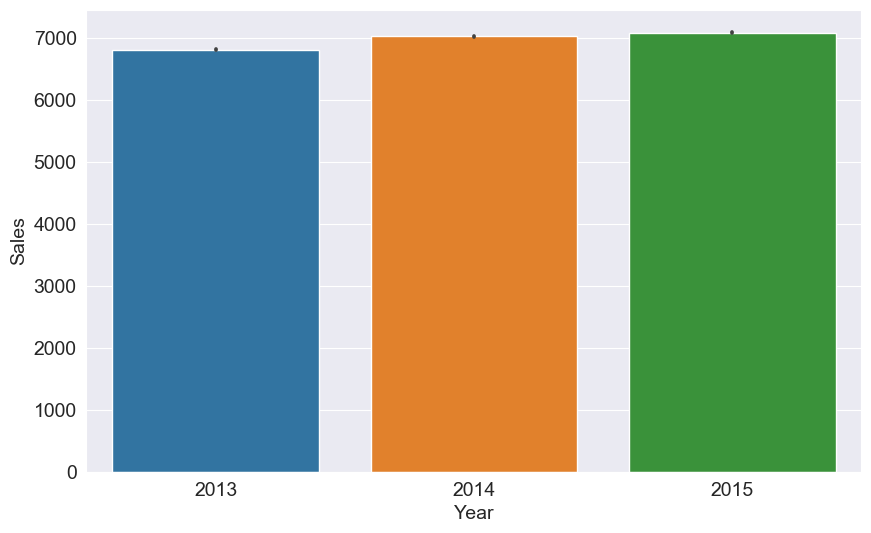

In [42]:
sns.barplot(merged_df, x='Year', y = 'Sales')
#plt.tick_params(axis='both', colors='white')
plt.show()

<AxesSubplot: xlabel='Month', ylabel='Sales'>

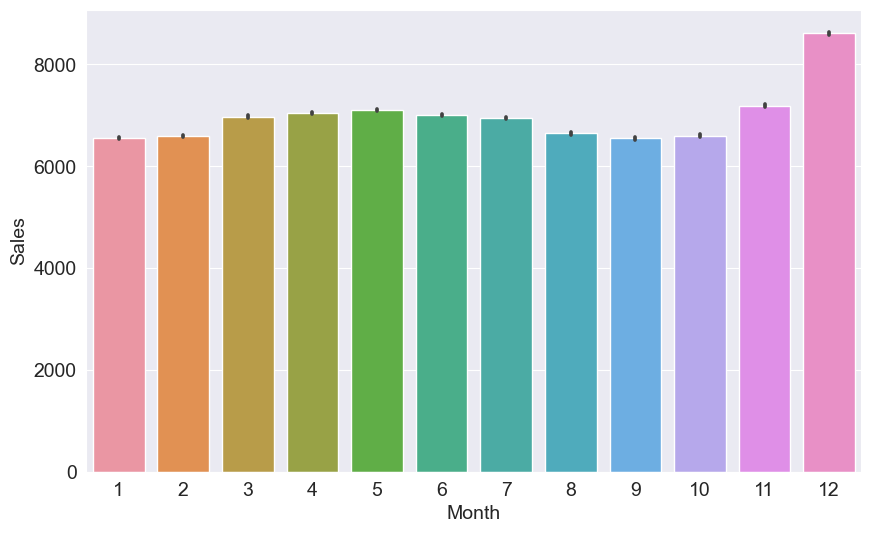

In [43]:
sns.barplot(data=merged_df, x='Month', y='Sales')
#plt.tick_params(axis='both', colors='white')


## Step 4 - Create a training/test/validation split and prepare the data for training


The data already contains a test set, which contains over one month of data after the end of the training set. We can apply a similar strategy to create a validation set. We'll the last 25% of rows for the validation set, after ordering by date

In [44]:
len(merged_df)

844392

In [45]:
train_size = int(.75*len(merged_df))
train_size

633294

In [46]:
test_size=len(merged_df) - train_size
test_size

211098

In [47]:
sorted_df = merged_df.sort_values('Date')
train_df, val_df = sorted_df[:train_size], sorted_df[train_size:]

In [48]:
len(train_df), len(val_df)

(633294, 211098)

In [49]:
train_df.Date.min(),train_df.Date.max()

(Timestamp('2013-01-01 00:00:00'), Timestamp('2014-12-10 00:00:00'))

In [50]:
val_df.Date.min(),val_df.Date.max()

(Timestamp('2014-12-10 00:00:00'), Timestamp('2015-07-31 00:00:00'))

In [51]:
merged_test_df.Date.min(), merged_test_df.Date.max()

(Timestamp('2015-08-01 00:00:00'), Timestamp('2015-09-17 00:00:00'))

In [52]:
train_df.columns

Index(['Store', 'DayOfWeek', 'Date', 'Sales', 'Customers', 'Open', 'Promo',
       'StateHoliday', 'SchoolHoliday', 'StoreType', 'Assortment',
       'CompetitionDistance', 'CompetitionOpenSinceMonth',
       'CompetitionOpenSinceYear', 'Promo2', 'Promo2SinceWeek',
       'Promo2SinceYear', 'PromoInterval', 'Day', 'Month', 'Year'],
      dtype='object')

### Input and Target columns
Let's also identify input and target columns. Note that we can't use the no. of customers as an input, because this information isn't available beforehand. Also, we needn't use all the available columns, we can start out with just a small subset.


In [63]:
input_cols = ['Store', 'DayOfWeek','Promo','StateHoliday',
             'StoreType', 'Assortment','Day', 'Month', 'Year']


In [64]:
target_colm= ['Sales']

Let's also separate out numeric and categorical columns.



In [65]:
merged_df[input_cols].nunique()

Store           1115
DayOfWeek          7
Promo              2
StateHoliday       4
StoreType          4
Assortment         3
Day               31
Month             12
Year               3
dtype: int64

In [66]:
merged_df[input_cols].dtypes

Store            int64
DayOfWeek        int64
Promo            int64
StateHoliday    object
StoreType       object
Assortment      object
Day              int64
Month            int64
Year             int64
dtype: object

In [67]:
merged_df.Promo.unique()

array([1, 0], dtype=int64)

In [68]:
merged_df.StateHoliday.unique()

array(['0', 'a', 'b', 'c'], dtype=object)

In [69]:
X_train = train_df[input_cols].copy()
y_train = train_df[target_colm].copy()

X_val=val_df[input_cols].copy()
y_val=val_df[target_colm].copy()

In [71]:
X_test = merged_test_df[input_cols].copy()

In [130]:
len(X_train_data), len(y_train)

(633294, 633294)

In [74]:
merged_df[target_colm].mean()

Sales    6955.514291
dtype: float64

In [75]:
X_test

,Store,DayOfWeek,Promo,StateHoliday,StoreType,Assortment,Day,Month,Year
0,1,4,1,0,c,a,17,9,2015
1,3,4,1,0,a,a,17,9,2015
2,7,4,1,0,a,c,17,9,2015
3,8,4,1,0,a,a,17,9,2015
4,9,4,1,0,a,c,17,9,2015
...,...,...,...,...,...,...,...,...,...
41083,1111,6,0,0,a,a,1,8,2015
41084,1112,6,0,0,c,c,1,8,2015
41085,1113,6,0,0,a,c,1,8,2015
41086,1114,6,0,0,a,c,1,8,2015


Note that some columns can be treated as both numeric and categorical, and it's up to us to decide how we want to deal with them.



In [76]:
numeric_cols = ['Store', 'Day', 'Month', 'Year']
categorical_cols = ['DayOfWeek','Promo','StateHoliday',
             'StoreType', 'Assortment']

### Imputation, Scaling and Encode


In [77]:
from sklearn.impute import SimpleImputer

In [78]:
imputer = SimpleImputer(strategy='mean').fit(X_train[numeric_cols])

In [79]:
X_train[numeric_cols].isna().sum()

Store    0
Day      0
Month    0
Year     0
dtype: int64

In [80]:
X_train[numeric_cols] = imputer.transform(X_train[numeric_cols])
X_val[numeric_cols] = imputer.transform(X_val[numeric_cols])
X_test[numeric_cols] = imputer.transform(X_test[numeric_cols])

Note that this step wasn't necessary for the store sales dataset, as there were no null values. Also, we can apply a different imputation strategy to different columns depending on their distributions (e.g. mean for normally distribute and median for exponentially distributed).

In [81]:
# lets scales the values to the (0,1) range

from sklearn.preprocessing import MinMaxScaler

In [82]:
scaler = MinMaxScaler().fit(X_train[numeric_cols])

In [83]:
X_train[numeric_cols] = scaler.transform(X_train[numeric_cols])
X_val[numeric_cols] = scaler.transform(X_val[numeric_cols])
X_test[numeric_cols] = scaler.transform(X_test[numeric_cols])

In [84]:
# Finally, let's encode categorical columns as one-hot vectors.

from sklearn.preprocessing import OneHotEncoder

In [85]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore').fit(X_train[categorical_cols])


In [86]:
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
encoded_cols

['DayOfWeek_1',
 'DayOfWeek_2',
 'DayOfWeek_3',
 'DayOfWeek_4',
 'DayOfWeek_5',
 'DayOfWeek_6',
 'DayOfWeek_7',
 'Promo_0',
 'Promo_1',
 'StateHoliday_0',
 'StateHoliday_a',
 'StateHoliday_b',
 'StateHoliday_c',
 'StoreType_a',
 'StoreType_b',
 'StoreType_c',
 'StoreType_d',
 'Assortment_a',
 'Assortment_b',
 'Assortment_c']

In [87]:
X_train[encoded_cols] = encoder.transform(X_train[categorical_cols])
X_val[encoded_cols] = encoder.transform(X_val[categorical_cols])
X_test[encoded_cols] = encoder.transform(X_test[categorical_cols])

In [88]:
X_train_data = X_train[numeric_cols+encoded_cols]
X_val_data = X_val[numeric_cols+encoded_cols]
X_test_data = X_test[numeric_cols+encoded_cols]

In [89]:
X_train_data.shape, X_val_data.shape, X_test_data.shape

((633294, 24), (211098, 24), (41088, 24))

## Step 5 - Create quick & easy baseline models to benchmark future models


### Fixed/Random Guess


Let's define a model that always returns the mean value of Sales as the prediction.



In [90]:
y_train.mean()


Sales    6873.179642
dtype: float64

In [91]:
y_train

,Sales
1017190,5961
1016179,4220
1016353,6851
1016356,17267
1016368,3102
...,...
256632,6897
256642,15736
256634,7444
256633,5207


In [92]:
def return_mean(inputs):
    return np.full(len(inputs), merged_df.Sales.mean())
    

In [93]:
train_preds = return_mean(X_train_data)
train_preds.mean()

6955.514290755959

In [94]:
# Let's evaluate this to using the RMSE score.

from sklearn.metrics import mean_squared_error

In [95]:
mean_squared_error(train_preds, y_train ,squared=False)

3082.450443277419

In [96]:
mean_squared_error(return_mean(X_val_data), y_val, squared=False)

3168.6033635047716

The model is off by about $3000 on average.
max=17k
min=3k
max-min = 14k
error = 3k/14k -> 0.21 sales prediction off by 20% roughly



#### Let's try another model, which makes a random guess between the lowest and highest sale.



In [97]:
merged_df.Sales.min(), merged_df.Sales.max()

(0, 41551)

In [98]:
def guess_random(inputs):
    # low,high = merged_df.Sales.min(), merged_df.Sales.max()
    low,high = 3000,15000
    return np.random.random(len(inputs)) * (high-low) + low

In [99]:
train_preds = guess_random(X_train_data)
train_preds

array([ 8463.61347019,  9680.27744681,  4102.74256556, ...,
        9342.40738606, 11125.03353016, 10517.9186108 ])

In [100]:
mean_squared_error(train_preds, y_train, squared=False)

5098.05767081825

In [101]:
mean_squared_error(guess_random(X_val_data), y_val, squared=False)

5016.958799243505

Clearly, this model is much worse.



### Hand-coded Strategies


EXERCISE: Write a function that implements the following strategy:

If the store is closed, return 0

.
If the store is open, return the average sales of the store for the current month in the previous year

.
Find the validation set score for this strategy.

#### Baseline ML model
Let's train a simple LinearRegression model, with no customization.




In [102]:
from sklearn.linear_model import LinearRegression

In [103]:

linreg = LinearRegression()

In [104]:
linreg.fit(X_train_data, y_train)

LinearRegression()

In [105]:
X_train_data.columns

Index(['Store', 'Day', 'Month', 'Year', 'DayOfWeek_1', 'DayOfWeek_2',
       'DayOfWeek_3', 'DayOfWeek_4', 'DayOfWeek_5', 'DayOfWeek_6',
       'DayOfWeek_7', 'Promo_0', 'Promo_1', 'StateHoliday_0', 'StateHoliday_a',
       'StateHoliday_b', 'StateHoliday_c', 'StoreType_a', 'StoreType_b',
       'StoreType_c', 'StoreType_d', 'Assortment_a', 'Assortment_b',
       'Assortment_c'],
      dtype='object')

In [106]:
linreg.coef_

array([[ 1.04821276e+02, -1.01022497e+02,  6.49749667e+02,
         1.03584179e+02,  1.75007414e+15,  1.75007414e+15,
         1.75007414e+15,  1.75007414e+15,  1.75007414e+15,
         1.75007414e+15,  1.75007414e+15,  5.35608068e+15,
         5.35608068e+15, -8.84650089e+13, -8.84650089e+13,
        -8.84650089e+13, -8.84650089e+13, -4.43002087e+14,
        -4.43002087e+14, -4.43002087e+14, -4.43002087e+14,
        -1.49589946e+15, -1.49589946e+15, -1.49589946e+15]])

In [107]:
train_preds = linreg.predict(X_train_data)
train_preds

array([[ 7130.],
       [10603.],
       [ 7052.],
       ...,
       [ 6247.],
       [ 6000.],
       [ 5621.]])

In [108]:
mean_squared_error(train_preds, y_train, squared=False)

2741.592530794578

In [109]:
val_preds = linreg.predict(X_val_data)
val_preds

array([[5621.],
       [5621.],
       [6001.],
       ...,
       [8636.],
       [8388.],
       [7827.]])

In [110]:
mean_squared_error(val_preds, y_val, squared=False)

2817.708759490225

Note that a simple linear regression model isn't much better than our fixed baseline model which always predicts the mean.

Based on the above baselines, we now know that any model we train should have ideally have a RMSE score lower than $2800. This baseline can also be conveyed to other stakeholders to get a sense of whether the range of loss makes sense. 

## Step 6 - Pick a strategy, train a model & tune hyperparameters


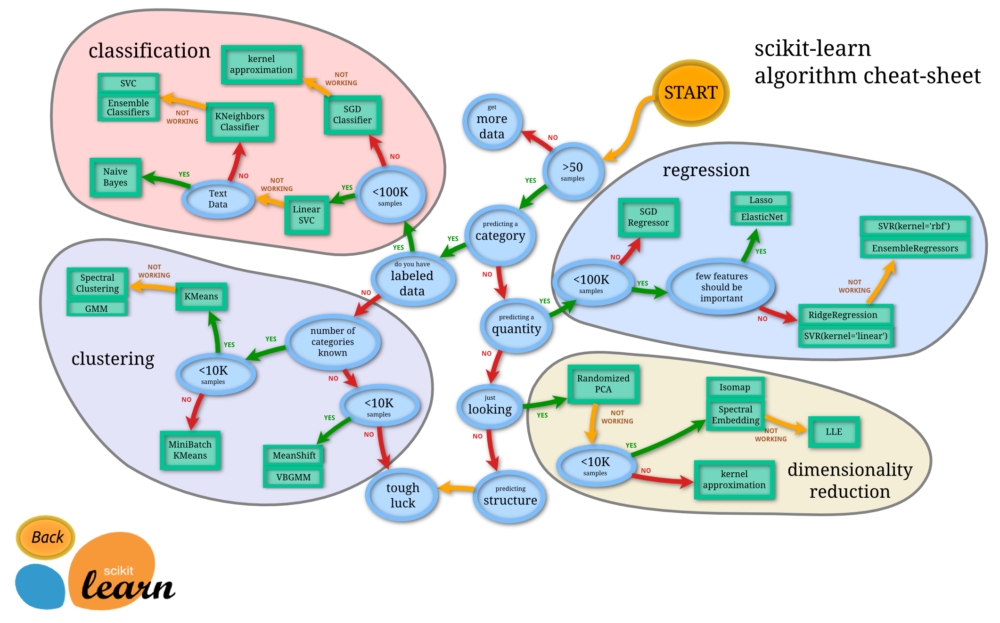

In [111]:
from IPython.display import Image
Image(filename='Images/models.png')

Here's the general strategy to follow:

* Find out which models are applicable to the problem you're solving.
* Train a basic version for each type of model that's applicable
* Identify the modeling approaches that work well and tune their hypeparameters
* Use a spreadsheet to keep track of your experiments and results.
* https://docs.google.com/spreadsheets/d/1S42lnklqdj4hS3BohffyvZVJOFBZJ61VDiHLMuf2zBw/edit#gid=1348262287





Let's define a function try_model, which takes a model, then performs training and evaluation.



In [112]:
def try_model(model):
    # Fit the model
    model.fit(X_train_data, y_train)
    
    # Generate predictions
    train_preds = model.predict(X_train_data)
    val_preds = model.predict(X_val_data)
    
    # Compute RMSE
    train_rmse = mean_squared_error(y_train, train_preds, squared=False)
    val_rmse = mean_squared_error(y_val,val_preds, squared=False)
    
    return train_rmse, val_rmse

    

### Linear Models

In [113]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, SGDRegressor

In [114]:
try_model(LinearRegression())

(2741.592530794578, 2817.708759490225)

In [115]:
try_model(Ridge())

(2741.587195081445, 2817.7784665409863)

In [116]:
try_model(Lasso())

(2741.7143904640566, 2817.9472924045217)

In [117]:
try_model(ElasticNet())

(2879.0432103903954, 2972.6658860503385)

In [118]:
try_model(SGDRegressor())

C:\Users\snikh\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



(2742.196082197193, 2822.689025020815)

### Tree Based Models


In [119]:
from sklearn.tree import DecisionTreeRegressor, plot_tree

In [120]:
tree = DecisionTreeRegressor(random_state=42)
try_model(tree)

(0.0, 1559.7378600480247)

Seems like the decision tree performs much better than linear models.



[Text(0.5, 0.9, 'Promo_0 <= 0.5\nsquared_error = 9494721.741\nsamples = 633294\nvalue = 6873.18'),
 Text(0.25, 0.7, 'DayOfWeek_1 <= 0.5\nsquared_error = 10053046.41\nsamples = 280741\nvalue = 8160.121'),
 Text(0.125, 0.5, 'Month <= 0.955\nsquared_error = 8559596.144\nsamples = 223344\nvalue = 7757.247'),
 Text(0.0625, 0.3, 'StoreType_b <= 0.5\nsquared_error = 7967330.328\nsamples = 210684\nvalue = 7631.861'),
 Text(0.03125, 0.1, '\n  (...)  \n'),
 Text(0.09375, 0.1, '\n  (...)  \n'),
 Text(0.1875, 0.3, 'Day <= 0.35\nsquared_error = 13800173.481\nsamples = 12660\nvalue = 9843.895'),
 Text(0.15625, 0.1, '\n  (...)  \n'),
 Text(0.21875, 0.1, '\n  (...)  \n'),
 Text(0.375, 0.5, 'Month <= 0.955\nsquared_error = 12775230.673\nsamples = 57397\nvalue = 9727.788'),
 Text(0.3125, 0.3, 'Day <= 0.95\nsquared_error = 11907411.6\nsamples = 54232\nvalue = 9578.715'),
 Text(0.28125, 0.1, '\n  (...)  \n'),
 Text(0.34375, 0.1, '\n  (...)  \n'),
 Text(0.4375, 0.3, 'Day <= 0.267\nsquared_error = 20739758.

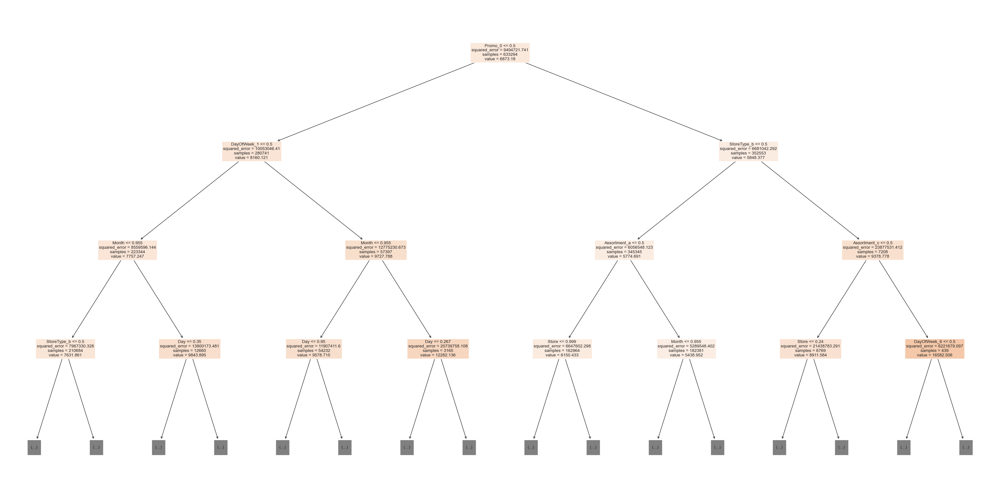

In [121]:
plt.figure(figsize=(40,20))
plot_tree(tree, max_depth=3, filled=True, feature_names=numeric_cols+encoded_cols)

Let's try a random forest.



In [122]:
from sklearn.ensemble import RandomForestRegressor

In [123]:
%%time
rf = RandomForestRegressor(random_state=42, n_jobs=-1)
try_model(rf)

C:\Users\snikh\AppData\Local\Temp\ipykernel_15296\1584837041.py:3: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



CPU times: total: 16min 5s
Wall time: 2min 59s


(474.9198974666898, 1371.7321923469985)

We've seen a significant reduction in the loss by using a random forest.



### Other Supervised Learning Models


https://scikit-learn.org/stable/supervised_learning.html

## Step 7 - Experiment and combine results from multiple strategies


In general, the following strategies can be used to improve the performance of a model:

* Gather more data. A greater amount of data can let you learn more relationships and generalize the model better.
* Include more features. The more relevant the features for predicting the target, the better the model gets.
* Tune the hyperparameters of the model. Increase the capacity of the model while ensuring that it doesn't overfit.
* Look at the specific examples where the model make incorrect or bad predictions and gather some insights
* Try strategies like grid search for hyperparameter optimization and K-fold cross validation
* Combine results from different types of models (ensembling), or train another model using their results.

### Hyperparameter Optimization & Grid Search


You can tune hyperparameters manually, our use an automated tuning strategy like random search or Grid search. Follow this tutorial for hyperparameter tuning using Grid search: https://machinelearningmastery.com/hyperparameter-optimization-with-random-search-and-grid-search/



#### K-Fold Cross Validation


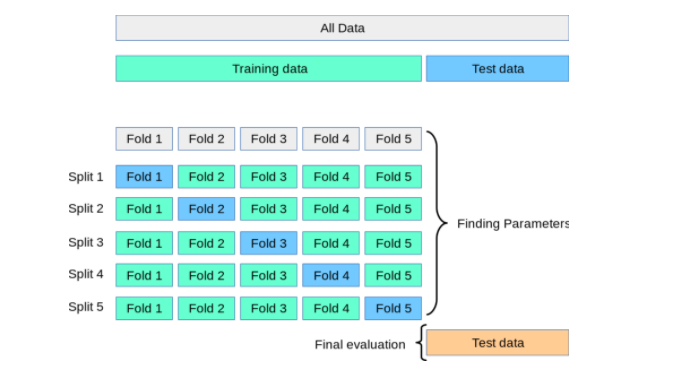

In [124]:
Image(filename='Images/kfold.png')

#### Ensembling and Stacking


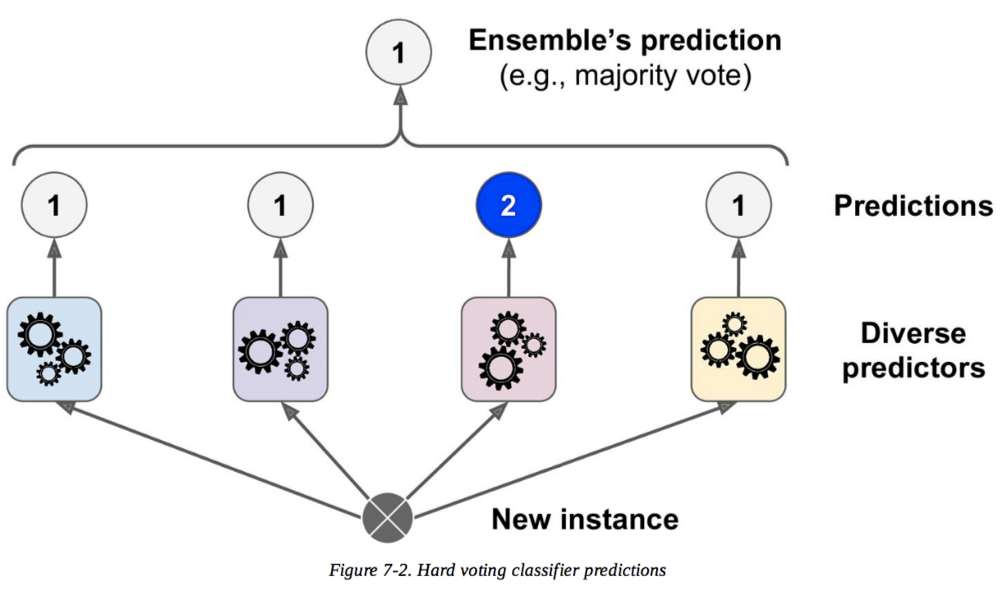

In [125]:
Image(filename='Images/stacking.png')

Stacking is a more advanced version of ensembling, where we train another model using the results from multiple models. Here's what stacking looks like visually (source):



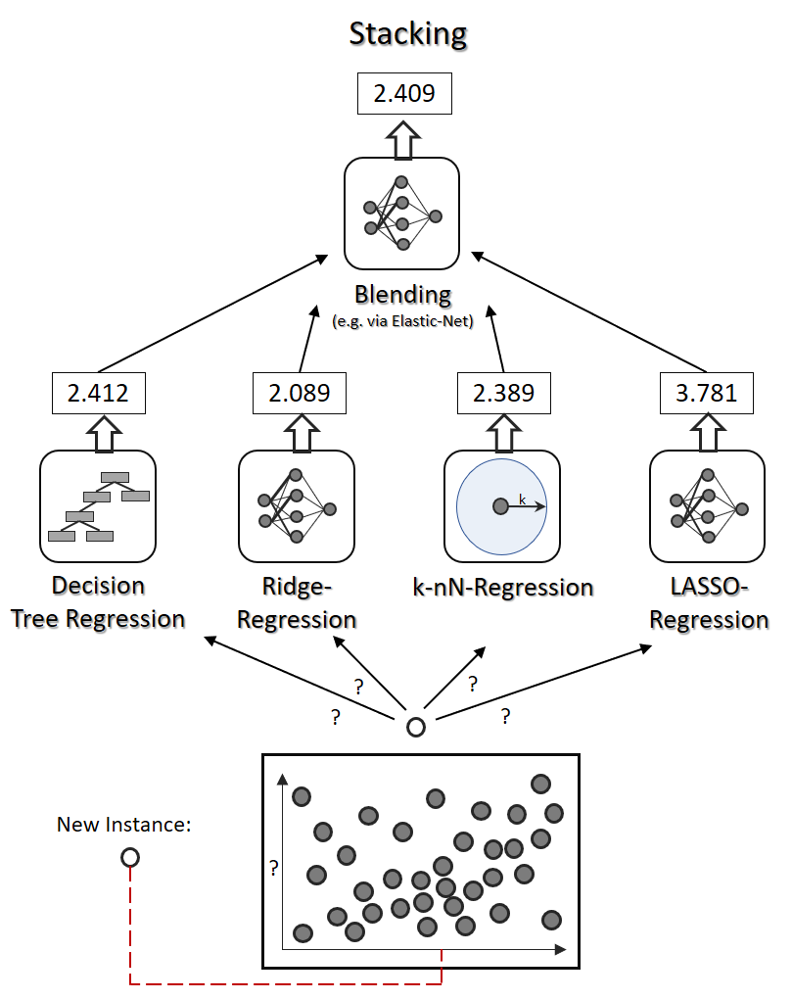

In [126]:
Image(filename='Images/stackin.png')

## Step 8 - Interpret models, study individual predictions & present your findings


### Feature Importance
You'll need to explain why your model returns a particular result. Most scikit-learn models offer some kind of "feature importance" score.



In [187]:
X_train_data.columns

Index(['Store', 'Day', 'Month', 'Year', 'DayOfWeek_1', 'DayOfWeek_2',
       'DayOfWeek_3', 'DayOfWeek_4', 'DayOfWeek_5', 'DayOfWeek_6',
       'DayOfWeek_7', 'Promo_0', 'Promo_1', 'StateHoliday_0', 'StateHoliday_a',
       'StateHoliday_b', 'StateHoliday_c', 'StoreType_a', 'StoreType_b',
       'StoreType_c', 'StoreType_d', 'Assortment_a', 'Assortment_b',
       'Assortment_c'],
      dtype='object')

In [186]:
rf.feature_importances_

array([6.07412101e-01, 4.88393196e-02, 4.71254150e-02, 9.30282826e-03,
       3.36941035e-02, 4.40591456e-03, 2.43735761e-03, 2.11467096e-03,
       5.71418981e-03, 6.96554452e-03, 4.47739863e-03, 5.83469269e-02,
       8.05201285e-02, 1.18767484e-03, 2.11472202e-04, 2.45172539e-05,
       1.88388455e-05, 1.38995265e-02, 2.25678813e-02, 1.04169805e-02,
       1.39945667e-02, 8.34303630e-03, 5.50125164e-03, 1.24783549e-02])

In [128]:
importance_df = pd.DataFrame({ 
    'feature': numeric_cols+encoded_cols, 
    'importance': rf.feature_importances_
}).sort_values('importance', ascending=False)
importance_df.head(10)

,feature,importance
0,Store,0.607412
12,Promo_1,0.080520
11,Promo_0,0.058347
1,Day,0.048839
2,Month,0.047125
4,DayOfWeek_1,0.033694
18,StoreType_b,0.022568
20,StoreType_d,0.013995
17,StoreType_a,0.013900
23,Assortment_c,0.012478


<AxesSubplot: xlabel='importance', ylabel='feature'>

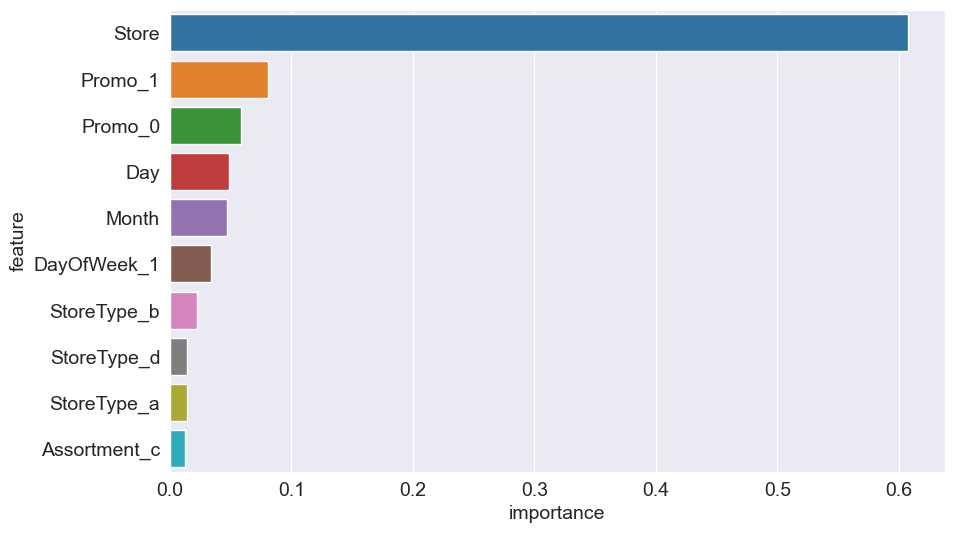

In [129]:
sns.barplot(data=importance_df.head(10), x='importance', y='feature')
#plt.tick_params(axis='both', colors='white')

### Looking at individual predictions


In [204]:
def predict_input(model, single_input):
    if single_input['Open'] == 0:
        return 0.
    input_df = pd.DataFrame([single_input])
    input_df['Date'] = pd.to_datetime(input_df.Date)
    input_df['Day'] = input_df.Date.dt.day
    input_df['Month'] = input_df.Date.dt.month
    input_df['Year'] = input_df.Date.dt.year
    input_df[numeric_cols] = imputer.transform(input_df[numeric_cols])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    X_input = input_df[numeric_cols + encoded_cols]
    pred = model.predict(X_input)[0]
    # prob= model.predict_proba(X_input)
    return pred#, prob

In [205]:
sample_input = {'Id': 1,
 'Store': 1,
 'DayOfWeek': 4,
 'Date': '2015-09-17 00:00:00',
 'Open': 1.0,
 'Promo': 1,
 'StateHoliday': '0',
 'SchoolHoliday': 0,
 'StoreType': 'c',
 'Assortment': 'a',
 'CompetitionDistance': 1270.0,
 'CompetitionOpenSinceMonth': 9.0,
 'CompetitionOpenSinceYear': 2008.0,
 'Promo2': 0,
 'Promo2SinceWeek': np.nan,
 'Promo2SinceYear': np.nan,
 'PromoInterval': np.nan}

sample_input

{'Id': 1,
 'Store': 1,
 'DayOfWeek': 4,
 'Date': '2015-09-17 00:00:00',
 'Open': 1.0,
 'Promo': 1,
 'StateHoliday': '0',
 'SchoolHoliday': 0,
 'StoreType': 'c',
 'Assortment': 'a',
 'CompetitionDistance': 1270.0,
 'CompetitionOpenSinceMonth': 9.0,
 'CompetitionOpenSinceYear': 2008.0,
 'Promo2': 0,
 'Promo2SinceWeek': nan,
 'Promo2SinceYear': nan,
 'PromoInterval': nan}

In [206]:
predict_input(rf, sample_input)

4258.01

Presenting your results:

* Create a presentation for non-technical stakeholders
* Understand your audience - figure out what they care about most
* Avoid showing any code or technical jargon, include visualizations
* Focus on metrics that are relevant for the business
* Talk about feature importance and how to interpret results
* Explain the strengths and limitations of the model
* Explain how the model can be improved over time

## Making a submission on Kaggle


In [208]:
test_preds = rf.predict(X_test_data)
test_preds

array([ 4258.01,  7713.83,  8775.7 , ...,  5954.68, 20823.07,  6748.48])

In [209]:
submission_df = pd.read_csv('./rossmann-store-sales/sample_submission.csv')
submission_df

,Id,Sales
0,1,0
1,2,0
2,3,0
3,4,0
4,5,0
...,...,...
41083,41084,0
41084,41085,0
41085,41086,0
41086,41087,0


In [211]:
submission_df['Sales'] = test_preds 
submission_df

,Id,Sales
0,1,4258.01
1,2,7713.83
2,3,8775.70
3,4,6775.37
4,5,6492.47
...,...,...
41083,41084,3052.40
41084,41085,9008.27
41085,41086,5954.68
41086,41087,20823.07


In [213]:
test_df['Open'].value_counts()

1.0    35093
0.0     5984
Name: Open, dtype: int64

In [214]:
submission_df['Sales'] = test_preds * test_df['Open'].fillna(1).astype('float')

In [216]:
submission_df.Sales.value_counts()

0.00       5984
7936.73       3
6694.66       3
8020.91       3
7870.50       3
           ... 
9293.86       1
8204.80       1
4210.08       1
8459.21       1
6748.48       1
Name: Sales, Length: 34313, dtype: int64

In [217]:
submission_df.to_csv('submission.csv', index=None)

In [221]:
from IPython.display import FileLink

In [222]:
FileLink('submission.csv')

C:\Users\snikh\myvenv\MachineLearningAlgo\submission.csv

## Revision Questions
1.	What are the steps involved in approaching a machine learning problem?
2.	What does problem identification mean?
3.	What is a loss function? Explain different loss functions.
4.	What is an evaluation metric? Explain different evaluation metrics.
5.	What is feature engineering?
6.	How does feature engineering help in building a better model?
7.	What is a baseline model?
8.	What is a hard-coded strategy?
9.	What are linear models?
10.	What are tree based models?
11.	What are some unsupervised machine learning problems?
12.	What are some strategies used to improve the performance of a model?
13.	What is grid-search?
14.	What is K-fold cross validation?
15.	What is ensembling? What are some ensemble methods?
16.	How does ensembling help in making better predictions?
17.	What is stacking?
18.	How does stacking help in making better predictions?
19.	What is model deployment?
20.	What are some model deployment frameworks? 